## Our Election Model
Now that we have built our features, we will use our dataset to create, test, and tune a number of potential models to predict Democratic or Republican counties.

Since our data indicates number of stores, we have ordinal data.  We could use dummy variables to make it categorical data, but this would make for an extremely large number of features.  Instead, we will calculate the number of stores per population, so that we are working with stores/person instead of integer stores.  This should make the data essentially continuous.

We start by reading in our data we wrote to file from the feature building notebook and making those small modifications.

We saved data for house races (US Congressional seats), major races (national and statewide races), and all races (local, state, and national).   Using all races improved the model by about 3% over the other datasets.

In [1]:
#import xgboost
import xgboost as xgb

# THIS WORKED. Save this info for later, it installs directly.
#import sys
#!{sys.executable} -m pip install xgboost

In [2]:
import pickle
import pandas as pd

# import data
# open the dataset of your choice (major_df, house_df, all_df)
with open('datasets/all_df.pkl', 'rb') as f:
    df = pickle.load(f)
    
with open('datasets/district_stores_df.pkl', 'rb') as f:
    dist_df = pickle.load(f)
    

dist_df = dist_df.drop(columns=['Unnamed: 0'], axis=1)
print(df.columns)
print(dist_df.columns)
df_raw = df.copy()  # saving an unaltered copy for later

#one last bit of feature engineering
#change data to be stores per 10k people
# revised to be per area
for col in df.columns:
    if col in ['state_fips', 'county', 'party', 'candidatevotes', 'fips', 'blue', 'population', 'area']:
        continue
    df[col] = df[col] / df['area']
    
# do same for house districts
dist_population = 711000
for col in dist_df.columns:
    if col in ['district', 'party', 'blue']:
        continue
    dist_df[col] = dist_df[col].apply(lambda x: x / dist_population)   
    
    

# red = [0 if x==1 else 1 for x in df['blue']]
# red
# df['red'] = red

df = df.drop(columns=['index'], axis=1)
pd.set_option('display.max_columns', None)
#df.isna().sum()  # It worked!
df = df.dropna()

df = df.rename({'ChickFila': 'ChickFilA'}, axis=1)
df.columns

# Now we have df and df_dist ready to go

# do same for binary
#df_raw = df.drop(columns=['index'], axis=1)
df_raw = df_raw.dropna()
df_raw = df_raw.rename({'ChickFila': 'ChickFilA'}, axis=1)



Index(['index', 'state_fips', 'county', 'party', 'candidatevotes',
       'totalvotes', 'fips', 'blue', 'WholeFoods', 'TractorSupply',
       'Starbucks', 'AcademySports', 'DicksSports', 'BassPro', 'DollarTree',
       'Grainger', 'ChickFila', 'CrackerBarrel', 'HarleyDavidson', 'HM',
       'HobbyLobby', 'LLBean', 'PotteryBarn', 'REI', 'Target', 'TraderJoes',
       'Walmart', 'Costco', 'population', 'area'],
      dtype='object')
Index(['district', 'WholeFoods', 'TractorSupply', 'Starbucks', 'AcademySports',
       'DicksSports', 'BassPro', 'Grainger', 'CrackerBarrel', 'HarleyDavidson',
       'HM', 'LLBean', 'PotteryBarn', 'REI', 'TraderJoes', 'Costco',
       'ChickFilA', 'DollarTree', 'HobbyLobby', 'Target', 'Walmart', 'party',
       'blue'],
      dtype='object')


In [3]:
#!pip install sklearn
df.head()

,state_fips,county,party,candidatevotes,totalvotes,fips,blue,WholeFoods,TractorSupply,Starbucks,AcademySports,DicksSports,BassPro,DollarTree,Grainger,ChickFilA,CrackerBarrel,HarleyDavidson,HM,HobbyLobby,LLBean,PotteryBarn,REI,Target,TraderJoes,Walmart,Costco,population,area
1,1,AUTAUGA,republican,225013.0,121372.886232,01001,0,0.0,0.000000,0.001682,0.000000,0.000000,0.000000,0.001682,0.0,0.001682,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.001682,0.0,55533,594.436
3,1,BALDWIN,republican,886133.0,45382.525551,01003,0,0.0,0.001887,0.003145,0.000629,0.000629,0.000629,0.005032,0.0,0.001887,0.001258,0.0,0.000629,0.001258,0.0,0.000629,0.0,0.001258,0.0,0.003774,0.0,217855,1589.784
5,1,BARBOUR,republican,66244.0,81535.054629,01005,0,0.0,0.001130,0.000000,0.000000,0.000000,0.000000,0.001130,0.0,0.001130,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.001130,0.0,24872,884.876
7,1,BIBB,republican,88177.0,115885.799782,01007,0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.001606,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.001606,0.0,22367,622.582
9,1,BLOUNT,republican,257928.0,111896.864958,01009,0,0.0,0.001551,0.000000,0.000000,0.000000,0.000000,0.001551,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.001551,0.0,57771,644.776


In [5]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score


import warnings
warnings.filterwarnings('ignore')



,index,state_fips,county,party,candidatevotes,totalvotes,fips,blue,WholeFoods,TractorSupply,Starbucks,AcademySports,DicksSports,BassPro,DollarTree,Grainger,ChickFilA,CrackerBarrel,HarleyDavidson,HM,HobbyLobby,LLBean,PotteryBarn,REI,Target,TraderJoes,Walmart,Costco,population,area
1,1,1,AUTAUGA,republican,225013.0,72148413.0,01001,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,55533,594.436
3,3,1,BALDWIN,republican,886133.0,72148413.0,01003,0,0,3,5,1,1,1,8,0,3,2,0,1,2,0,1,0,2,0,6,0,217855,1589.784
5,5,1,BARBOUR,republican,66244.0,72148413.0,01005,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,24872,884.876
7,7,1,BIBB,republican,88177.0,72148413.0,01007,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,22367,622.582
9,9,1,BLOUNT,republican,257928.0,72148413.0,01009,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,57771,644.776


In [5]:
# I am choosing to train on the 3000+ counties in the USA, and test on the 435 congressional districts 
# to predict the congressional race for 2018

# Make my X and y data  AND FEATURE SELECTION
y = df['blue']
y_dist = dist_df['blue']

extra_cols = ['totalvotes', 
              'county', 
              'party', 
              'fips', 
              'state_fips', 
              'candidatevotes', 
              'blue',
              'population',
              'area',
             ]

extra_cols_dist = ['party', 'blue', 'district']

drop_cols = ['AcademySports',
             'BassPro',
             'CrackerBarrel',
             'LLBean',
             'PotteryBarn',
             'REI',
             'DicksSports',
             'Grainger',
             'ChickFilA',
             'HarleyDavidson',
            ]
             
dem_cols = ['TraderJoes',
            'Costco',
            'Starbucks',
            'HM',
            'Target',
            'WholeFoods'
           ]  

gop_cols = ['TractorSupply',
            'HobbyLobby',
            'Walmart',
            'DollarTree'
            ]

X = df.drop(columns=extra_cols+drop_cols)  # + drop_cols when you want to drop multiples
X_dist = dist_df.drop(columns=extra_cols_dist+drop_cols)


# get my cols to line up
X_dist = X_dist[X.columns]






In [6]:
df['blue'].sum()
df['party'].value_counts()  # vals are same.  Just verification
X.columns

Index(['WholeFoods', 'TractorSupply', 'Starbucks', 'DollarTree', 'HM',
       'HobbyLobby', 'Target', 'TraderJoes', 'Walmart', 'Costco'],
      dtype='object')

In [7]:
# Scale my data
# scaler = StandardScaler()
# X_scaled = scaler.fit_transform(X)

In [8]:
# Split my data

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=0)


# XGBoost model

In [9]:
# We will skip scaling of the data.  It is already all in the same units (stores per 10k population)
# The data is very homogenous at this point

# after we do the model, we can trim the fat.  Not all stores will be important.

# MAKE A BASELINE MODEL
xg_clf = xgb.XGBClassifier()
xg_clf.fit(X_train, y_train)

# Make predictions and measure accuracy
training_preds = xg_clf.predict(X_train)
val_preds = xg_clf.predict(X_test)

training_accuracy = accuracy_score(y_train, training_preds)
val_accuracy = accuracy_score(y_test, val_preds)

print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))

Training Accuracy: 93.63%
Validation accuracy: 83.9%


### XGBoost Model Tuning

In [10]:
# TUNING
param_grid = {
    "learning_rate": [0.01],   # 0.1, 0.01, 0.03, 0.04
    'n_estimators': [1000],  # 1000, 500, 250
    'max_depth': [6], # prevent over/under fitting 4 to 9
    'min_child_weight': [0.3],
    'colsample_bytree':[0.9],  # tried 0.5 to 1
    #'subsample': [0.85],
    #'gamma': [0],  # did not affect
    'scale_pos_weight': [0.3, 0.4, 0.5,],
    'random_state': [0]
}
print(len(df[df['blue']==1])/len(df))

0.19497260715436673


In [11]:
grid_clf = GridSearchCV(xg_clf, param_grid, scoring='accuracy', cv=5, n_jobs=1)
grid_clf.fit(X_train, y_train)

best_parameters = grid_clf.best_params_

print("Grid Search found the following optimal parameters: ")
for param_name in sorted(best_parameters.keys()):
    print("%s: %r" % (param_name, best_parameters[param_name]))

training_preds = grid_clf.predict(X_train)
val_preds = grid_clf.predict(X_test)
training_accuracy = accuracy_score(y_train, training_preds)
val_accuracy = accuracy_score(y_test, val_preds)

print("")
print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))

Grid Search found the following optimal parameters: 
colsample_bytree: 0.9
learning_rate: 0.01
max_depth: 6
min_child_weight: 0.3
n_estimators: 1000
random_state: 0
scale_pos_weight: 0.5

Training Accuracy: 89.93%
Validation accuracy: 85.83%


## XGBoost Final Model

In [12]:
# Decision Tree
import pandas as pd
import numpy as np
np.random.seed(0)
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier

# MAKE A BASELINE MODEL
xg_final = xgb.XGBClassifier(learning_rate=0.01,
                             n_estimators=200,
                             max_depth=4,
                             min_child_weight=0.4,  # higher is more conservative
                             #colsample_bytree=0.9,
                             scale_pos_weight=4,
                             random_state=0,
                             #subsample=0.5,
                            )

xg_final.fit(X_train, y_train)

# Make predictions and measure accuracy
training_preds = xg_final.predict(X_train)
val_preds = xg_final.predict(X_test)

training_accuracy = accuracy_score(y_train, training_preds)
val_accuracy = accuracy_score(y_test, val_preds)

print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))

Training Accuracy: 82.8%
Validation accuracy: 79.55%


The XGBoost model performed very well as a baseline.  When weighted for the imbalance of the dataset, it began to lose the high accuracy.  The peak performance of the model was 88%, but without any weighting.  Under these conditions, the model missed far too many Democratic counties to be a useful predictive model.

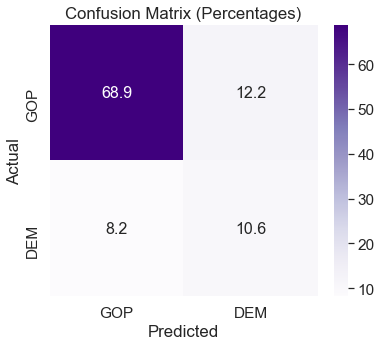

(0.8127511856409706, 0.7954911433172303, 0.802760691477574, None)

In [13]:
#forest.fit(X_train, y_train)
import pandas as pd
import seaborn as sn
import matplotlib.pyplot as plt
%matplotlib inline
import itertools
import matplotlib.pyplot as plt 
from sklearn.metrics import precision_recall_fscore_support


#plot_feature_importances(forest)
cm = confusion_matrix(y_test, xg_final.predict(X_test))
cm = cm/cm.sum()*100
cm = cm.round(1)




plt.figure(figsize = (6,5))
sn.set_context('poster')
sn.set(font_scale=1.4)#for label size
sn.heatmap(cm, cmap="Purples", annot=True, fmt='g', annot_kws={"size": 16})# font size

plt.title("Confusion Matrix (Percentages)")
plt.xlabel('Predicted')
plt.ylabel('Actual')
# Hide major tick labels


# Customize minor tick labels
plt.xticks([0.5, 1.5], ['GOP','DEM'])
plt.yticks([0.5, 1.5], ['GOP','DEM'])


#plt.annotate("GOP: 0, DEM: 1", [1.5,0.1], fontsize=10)
plt.show()
# worked with other environment


# accuracy 
precision_recall_fscore_support(y_test, xg_final.predict(X_test), average='weighted')

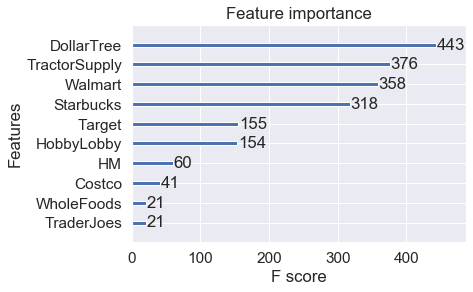

In [14]:
# plot feature importance
xgb.plot_importance(xg_clf)

The feature plot

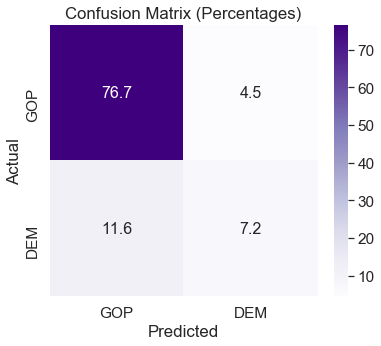

(0.8211019477762369, 0.8389694041867954, 0.8236913162390187, None)

In [15]:
#forest.fit(X_train, y_train)
import pandas as pd
import seaborn as sn
import matplotlib.pyplot as plt
%matplotlib inline
import itertools
import matplotlib.pyplot as plt 
from sklearn.metrics import precision_recall_fscore_support


#plot_feature_importances(forest)
cm = confusion_matrix(y_test, xg_clf.predict(X_test))
cm = cm/cm.sum()*100
cm = cm.round(1)




plt.figure(figsize = (6,5))
sn.set_context('poster')
sn.set(font_scale=1.4)#for label size
sn.heatmap(cm, cmap="Purples", annot=True, fmt='g', annot_kws={"size": 16})# font size

plt.title("Confusion Matrix (Percentages)")
plt.xlabel('Predicted')
plt.ylabel('Actual')
# Hide major tick labels


# Customize minor tick labels
plt.xticks([0.5, 1.5], ['GOP','DEM'])
plt.yticks([0.5, 1.5], ['GOP','DEM'])


#plt.annotate("GOP: 0, DEM: 1", [1.5,0.1], fontsize=10)
plt.show()
# worked with other environment


# accuracy 
precision_recall_fscore_support(y_test, xg_clf.predict(X_test), average='weighted')

# Decision Tree and Random Forest

### Baseline Decision Tree

In [16]:
def plot_feature_importances(model):
    n_features = X_train.shape[1]
    plt.figure(figsize=(8,8))
    plt.barh(range(n_features), model.feature_importances_, align='center', color='purple') 
    plt.yticks(np.arange(n_features), X_train.columns.values) 
    plt.xlabel('Feature importance')
    plt.ylabel('Feature')

In [17]:
# Decision Tree
import pandas as pd
import numpy as np
np.random.seed(0)
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier

In [18]:
# Instantiate and fit a DecisionTreeClassifier
np.random.seed(337)

tree_clf = DecisionTreeClassifier(criterion='entropy', 
                                  max_depth=3,
                                  max_features=3,
                                  random_state=0,
                                 ) 
tree_clf.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=3, max_features=3, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=0, splitter='best')

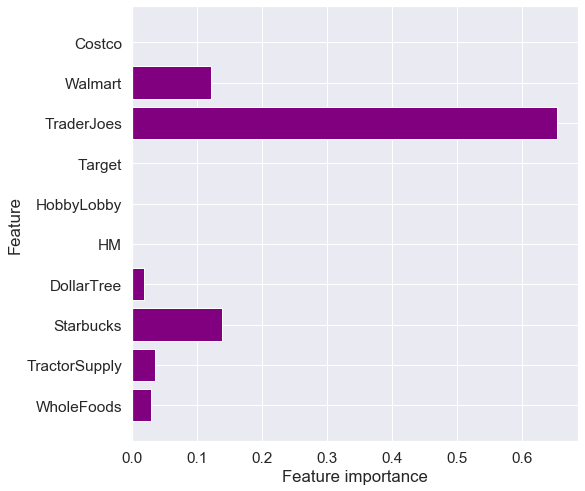

In [19]:


plot_feature_importances(tree_clf)


After investigating a number of simple decision trees, it became obvious that Trader Joe's was by far the most important feature in single trees.  The presence of a Trader Joe's in a voting district alone is good for 82% prediction rate.

In [20]:
from sklearn.metrics import accuracy_score

training_preds = tree_clf.predict(X_train)
val_preds = tree_clf.predict(X_test)
training_accuracy = accuracy_score(y_train, training_preds)
val_accuracy = accuracy_score(y_test, val_preds)

print("")
print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))


Training Accuracy: 84.49%
Validation accuracy: 85.51%


## Random Forest

In [21]:
# RANDOM FOREST CONTINUED 

import pandas as pd
import numpy as np
np.random.seed(1)
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier

### Random Forest Tuning

In [22]:
# Instantiate random forest
forest = RandomForestClassifier()

In [23]:
# TUNING
rf_param_grid = {
    'n_estimators': [1000, 700, 500],
    'criterion': ['gini', 'entropy'],
    #'max_depth': [3,4,5,6],
    #'min_samples_split': [3,4,5,6,7],
    #'min_samples_leaf': [4,5,6],
    'class_weight': [{0:1, 1:2}]
}


rf_param_grid = {
    'n_estimators': [700],
    'criterion': ['entropy'],
    'max_depth': [6],
    'min_samples_split': [10],
    'min_samples_leaf': [5],
    'random_state': [0],
    #'class_weight': [{0:1, 1:3}]
    'class_weight': ['balanced']
}

In [24]:
grid_clf = GridSearchCV(forest, rf_param_grid, scoring='accuracy', cv=5, n_jobs=1)
grid_clf.fit(X_train, y_train)

best_parameters = grid_clf.best_params_

print("Grid Search found the following optimal parameters: ")
for param_name in sorted(best_parameters.keys()):
    print("%s: %r" % (param_name, best_parameters[param_name]))

training_preds = grid_clf.predict(X_train)
val_preds = grid_clf.predict(X_test)
training_accuracy = accuracy_score(y_train, training_preds)
val_accuracy = accuracy_score(y_test, val_preds)

print("")
print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))

Grid Search found the following optimal parameters: 
class_weight: 'balanced'
criterion: 'entropy'
max_depth: 6
min_samples_leaf: 5
min_samples_split: 10
n_estimators: 700
random_state: 0

Training Accuracy: 85.17%
Validation accuracy: 83.74%


## Random Forest Model


In [25]:
# Instantiate and fit a RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score


forest = RandomForestClassifier(criterion='gini',
                                max_depth=5,
                                #max_features=5,
                                min_samples_leaf=3,
                                min_samples_split=10,
                                n_estimators=1000,
                                random_state=0,
                                #class_weight='balanced',
                                class_weight={1:3},
                               )  # tuned for population

forest = RandomForestClassifier(criterion='entropy',
                                max_depth=5,
                                #max_features=5,
                                min_samples_leaf=3,
                                min_samples_split=10,
                                n_estimators=200,
                                random_state=0,
                                #class_weight='balanced',
                                class_weight={1:3},
                               ) # tuned for area

forest.fit(X_train, y_train)
mean_rf_cv_score_train = np.mean(cross_val_score(forest, X_train, y_train, cv=5))
mean_rf_cv_score = np.mean(cross_val_score(forest, X_test, y_test, cv=5))

print(f"Mean Cross Validation Score for Random Forest Classifier Train: {mean_rf_cv_score_train :.2%}")
print(f"Mean Cross Validation Score for Random Forest Classifier Test: {mean_rf_cv_score :.2%}")

Mean Cross Validation Score for Random Forest Classifier Train: 83.72%
Mean Cross Validation Score for Random Forest Classifier Test: 85.50%


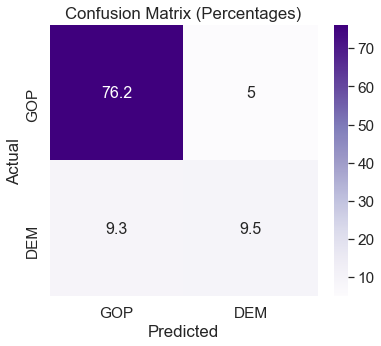

(0.8464559622260434, 0.856682769726248, 0.8492053490163132, None)

In [26]:
#forest.fit(X_train, y_train)
import pandas as pd
import seaborn as sn
import matplotlib.pyplot as plt
%matplotlib inline
import itertools
import matplotlib.pyplot as plt 
from sklearn.metrics import precision_recall_fscore_support


#plot_feature_importances(forest)
cm = confusion_matrix(y_test, forest.predict(X_test))
cm = cm/cm.sum()*100
cm = cm.round(1)




plt.figure(figsize = (6,5))
sn.set_context('poster')
sn.set(font_scale=1.4)#for label size
sn.heatmap(cm, cmap="Purples", annot=True, fmt='g', annot_kws={"size": 16})# font size

plt.title("Confusion Matrix (Percentages)")
plt.xlabel('Predicted')
plt.ylabel('Actual')
# Hide major tick labels


# Customize minor tick labels
plt.xticks([0.5, 1.5], ['GOP','DEM'])
plt.yticks([0.5, 1.5], ['GOP','DEM'])


#plt.annotate("GOP: 0, DEM: 1", [1.5,0.1], fontsize=10)
plt.show()
# worked with other environment


# accuracy 
precision_recall_fscore_support(y_test, forest.predict(X_test), average='weighted')

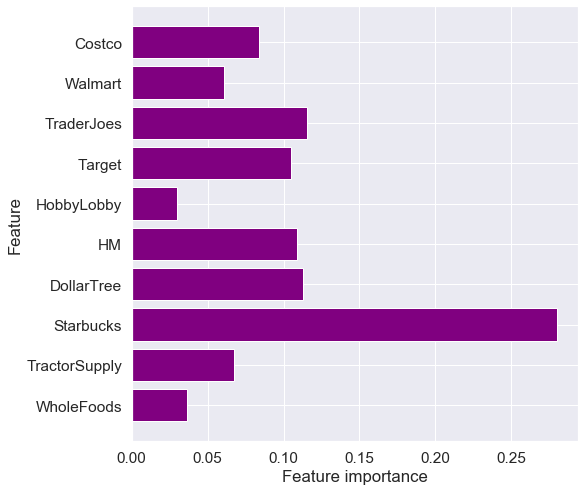

In [27]:
plot_feature_importances(forest)


## Random Forest Visualization

In [28]:
# !conda install -c anaconda pydotplus --yes
# !conda uninstall anaconda pydotplus --yes
# !conda install pydotplus --yes
# !conda install graphviz

In [29]:

import pydotplus
from sklearn import tree

# Train
# Extract single tree
estimator = forest.estimators_[0]
#estimator = tree_clf

from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = X.columns,
                class_names = ['red','blue'],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=200'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')



ModuleNotFoundError: No module named 'pydotplus'

## Boruta Feature Selection

In [32]:
!conda install -c conda-forge boruta_py --yes


Solving environment: done

# All requested packages already installed.



In [31]:

import pandas
from sklearn.ensemble import RandomForestClassifier
from boruta import BorutaPy
 
# load X and y  DONE
# X = pd.read_csv('my_X_table.csv', index_col=0).values
# y = pd.read_csv('my_y_vector.csv', index_col=0).values
 
# define random forest classifier, with utilising all cores and
# sampling in proportion to y labels DONE
#forest = RandomForestClassifier(n_jobs=-1, class_weight='auto')
 
# define Boruta feature selection method
feat_selector = BorutaPy(xg_clf, n_estimators='auto', verbose=2)
 
# find all relevant features
feat_selector.fit(X_train.values, y_train.values)
 
# # check selected features
feat_selector.support_
 
# # check ranking of features
feat_selector.ranking_
 
# # call transform() on X to filter it down to selected features
X_filtered = feat_selector.transform(X_train.values)


ModuleNotFoundError: No module named 'boruta'

In [ ]:
list(zip(feat_selector.ranking_, X.columns))
#!conda install -c conda-forge boruta_py --yes
#!conda install -c anaconda py-xgboost --yes



In [125]:
import plotly.express as px
from urllib.request import urlopen


def make_choro(df, geojson, col, color_list, range_color):
    fig = px.choropleth(df, 
                        geojson=geojson, 
                        locations='fips', 
                        color=col,
                        #color_discrete_sequence=px.colors.qualitative.Set1,
                        color_continuous_scale=color_list,
                        range_color=range_color,
                        scope="usa",
            #                     labels={'WholeFoods':'Whole Foods',
            #                             'county': 'County'},
                        hover_name='county',
                        hover_data=[col, 'party'],
                    )
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.show()

with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    us_county_fix = json.load(response)



In [408]:
import plotly.express as px
df['pred'] = forest.predict(X)

df['misses'] = df['pred'] + df['blue']
df['misses'] = df['misses'].apply(lambda x: 0 if x%2==0 else 1)

#make_choro(df, us_county_fix, 'pred', ['red', 'blue'], [0, 1])
make_choro(df, us_county_fix, 'blue', ['red', 'blue'], [0, 1])
#make_choro(df, us_county_fix, 'misses', ['white', 'purple'], [0, 1])



## Try our model on congressional districts

In [127]:
import geopandas as gpd

finalvotes_df = pd.read_pickle('datasets/finalvotes_df.pkl')
dist_df = pd.read_pickle('datasets/district_stores_df.pkl')

In [131]:
# MAKE A GEOPANDAS DF
# load my geojson file which contains my Polygons
boundary_file = "datasets/dist3.geojson"
geo_data = gpd.read_file(boundary_file)   


abbrev_dict = {
    'Alabama': 'AL',
    'Alaska': 'AK',
    'American Samoa': 'AS',
    'Arizona': 'AZ',
    'Arkansas': 'AR',
    'California': 'CA',
    'Colorado': 'CO',
    'Connecticut': 'CT',
    'Delaware': 'DE',
    'District of Columbia': 'DC',
    'Florida': 'FL',
    'Georgia': 'GA',
    'Guam': 'GU',
    'Hawaii': 'HI',
    'Idaho': 'ID',
    'Illinois': 'IL',
    'Indiana': 'IN',
    'Iowa': 'IA',
    'Kansas': 'KS',
    'Kentucky': 'KY',
    'Louisiana': 'LA',
    'Maine': 'ME',
    'Maryland': 'MD',
    'Massachusetts': 'MA',
    'Michigan': 'MI',
    'Minnesota': 'MN',
    'Mississippi': 'MS',
    'Missouri': 'MO',
    'Montana': 'MT',
    'Nebraska': 'NE',
    'Nevada': 'NV',
    'New Hampshire': 'NH',
    'New Jersey': 'NJ',
    'New Mexico': 'NM',
    'New York': 'NY',
    'North Carolina': 'NC',
    'North Dakota': 'ND',
    'Northern Mariana Islands':'MP',
    'Ohio': 'OH',
    'Oklahoma': 'OK',
    'Oregon': 'OR',
    'Pennsylvania': 'PA',
    'Puerto Rico': 'PR',
    'Rhode Island': 'RI',
    'South Carolina': 'SC',
    'South Dakota': 'SD',
    'Tennessee': 'TN',
    'Texas': 'TX',
    'Utah': 'UT',
    'Vermont': 'VT',
    'Virgin Islands': 'VI',
    'Virginia': 'VA',
    'Washington': 'WA',
    'West Virginia': 'WV',
    'Wisconsin': 'WI',
    'Wyoming': 'WY',
    'District Of Columbia': 'DC',
}

codes = []

# Make the codes in geo and df match
geo_data['DISTRICT'] = geo_data['DISTRICT'].apply(lambda x: '1' if x=='0' else x)



for i in range(len(geo_data)):
    code = '{}-{:02}'.format(abbrev_dict[geo_data.iloc[i]['STATENAME']], int(geo_data.iloc[i]['DISTRICT']))
    codes.append(code)
    
geo_data['Code'] = codes
#geo_data['DISTRICT'] = geo_data['DISTRICT'].apply(lambda x: str(x))

finalvotes_df.iloc[:]['Code'] = finalvotes_df['district']
finalvotes_df['district'] = finalvotes_df['district'].apply(lambda x: str(x))



# df['Code'].unique()
# finalvotes_df['Code'].unique()
geo_data.head()



# MAYBE I NEED TO PUT THE PARTY INTO THE geo_data?????
party = []

In [133]:
###### FIX ME


y_pred = forest.predict(X_dist)
dist_df['pred'] = y_pred


training_preds = forest.predict(X_train)  # train with all counties
val_preds = forest.predict(X_dist)  # test with all dists
training_accuracy = accuracy_score(y_train, training_preds)
val_accuracy = accuracy_score(y_dist, val_preds)

print("")
print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))



Training Accuracy: 85.82%
Validation accuracy: 74.71%


In [134]:

import folium


import folium
import json
import numpy as np
import branca.colormap as cm

# create a LinearColorMap and assign colors, vmin, and vmax
# the colormap will show green for $100,000 homes all the way up to red for $1,500,000 homes
colormap = cm.LinearColormap(colors=['red', 'blue'], vmin=0, vmax=1)


center= (39.8283, -98.5795,)

def my_color_function(feature):
    """Maps low values to red and high values to blue."""
    if feature == 1:
        return '#0000FF'
    else:
        return '#FF0000'

def folium_del_legend(choropleth: folium.Choropleth):
  """A hack to remove choropleth legends.
  
  The choropleth color-scaled legend sometimes looks too crowded. Until there is an
  option to disable the legend, use this routine to remove any color map children
  from the choropleth.
  
  Args:
    choropleth: Choropleth objected created by `folium.Choropleth()`
    
  Returns:
    The same object `choropleth` with any child whose name starts with
    'color_map' removed.
  """
  del_list = []
  for child in choropleth._children:
    if child.startswith('color_map'):
      del_list.append(child)
  for del_item in del_list:
    choropleth._children.pop(del_item)
  return choropleth
    
    
# Initialize Folium Map again (same as before)
m = folium.Map(location=center, 
               zoom_start=4,
               tiles='Stamen Toner')


# Create choropleth map  

folium_del_legend(folium.Choropleth(
    geo_data=geo_data,
    name='choropleth',
    data=dist_df,
    columns=['district', 'pred'],
    key_on='feature.properties.Code', 
    fill_color='Spectral',
    line_width=1,
    fill_opacity=0.6,
    #nan_fill_opacity=0,
    #line_opacity=1,
    #legend_name='Stores',
).add_to(m))



m

In [135]:
df.head()

,state_fips,county,party,candidatevotes,totalvotes,fips,blue,WholeFoods,TractorSupply,Starbucks,AcademySports,DicksSports,BassPro,DollarTree,Grainger,ChickFilA,CrackerBarrel,HarleyDavidson,HM,HobbyLobby,LLBean,PotteryBarn,REI,Target,TraderJoes,Walmart,Costco,population,area,pred
1,1,AUTAUGA,republican,225013.0,1299.198909,01001,0,0.0,0.000000,0.000018,0.000000,0.000000,0.000000,0.000018,0.0,0.000018,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000018,0.0,55533,594.436,0
3,1,BALDWIN,republican,886133.0,331.176301,01003,0,0.0,0.000014,0.000023,0.000005,0.000005,0.000005,0.000037,0.0,0.000014,0.000009,0.0,0.000005,0.000009,0.0,0.000005,0.0,0.000009,0.0,0.000028,0.0,217855,1589.784,0
5,1,BARBOUR,republican,66244.0,2900.788557,01005,0,0.0,0.000040,0.000000,0.000000,0.000000,0.000000,0.000040,0.0,0.000040,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000040,0.0,24872,884.876,0
7,1,BIBB,republican,88177.0,3225.663388,01007,0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000045,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000045,0.0,22367,622.582,0
9,1,BLOUNT,republican,257928.0,1248.869035,01009,0,0.0,0.000017,0.000000,0.000000,0.000000,0.000000,0.000017,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000017,0.0,57771,644.776,0


In [136]:
import pandas as pd
import numpy as np
np.random.seed(0)
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier

In [144]:
# BAGGING

# Instantiate a BaggingClassifier
bagged_tree =  BaggingClassifier(DecisionTreeClassifier(criterion='entropy',
                                                        max_depth=6,
                                                        min_samples_leaf=4,
                                                        min_samples_split=5,
                                                       )
                                                        ,n_estimators=1000)
                                                        

# Fit to the training data
bagged_tree.fit(X_train, y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                        class_weight=None,
                                                        criterion='entropy',
                                                        max_depth=6,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=4,
                                                        min_samples_split=5,
                                                        min_weight_fraction_leaf=0.0,
                                                        presort='deprecated',
                                                        random_state=None,


In [145]:
bagged_tree.score(X_train, y_train)


0.8694601128122482

In [146]:
bagged_tree.score(X_test, y_test)


0.8711755233494364

# Binary treatment
I noticed that the trees had a lot of branches that only checked to see if the store was in the county (>0).
What if our dataset only contained yes/no 'is there a store in your county'?

In [147]:
Xbin = X.copy()

for col in Xbin.columns:
    Xbin[col] = Xbin[col].apply(lambda x: 1 if x>0 else 0)
    
Xbin.head()



,WholeFoods,TractorSupply,Starbucks,DollarTree,HM,HobbyLobby,Target,TraderJoes,Walmart,Costco
1,0,0,1,1,0,0,0,0,1,0
3,0,1,1,1,1,1,1,0,1,0
5,0,1,0,1,0,0,0,0,1,0
7,0,0,0,1,0,0,0,0,1,0
9,0,1,0,1,0,0,0,0,1,0


In [148]:
# now do same stuff as before
# Instantiate and fit a DecisionTreeClassifier
np.random.seed(337)

bintree_clf = RandomForestClassifier(criterion='entropy', 
                                  max_depth=5,
                                  max_features=7,
                                  min_samples_leaf=5,
                                  min_samples_split=10,
                                  class_weight='balanced',
                                  random_state=337,
                                    ) 

Xbin_train, Xbin_test, ybin_train, ybin_test = train_test_split(Xbin, y, test_size=0.25, random_state=337)

bintree_clf.fit(Xbin, y)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='entropy', max_depth=5, max_features=7,
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=5, min_samples_split=10,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=337,
                       verbose=0, warm_start=False)

In [149]:
training_preds = bintree_clf.predict(Xbin_train)
val_preds = bintree_clf.predict(Xbin_test)
training_accuracy = accuracy_score(ybin_train, training_preds)
val_accuracy = accuracy_score(ybin_test, val_preds)

print("")
print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))


Training Accuracy: 78.21%
Validation accuracy: 78.09%


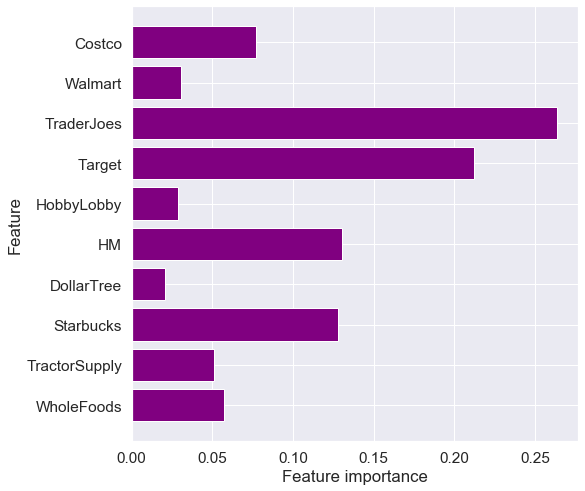

In [150]:
plot_feature_importances(bintree_clf)

In [151]:
import pydotplus
from sklearn import tree

# Train
# Extract single tree
estimator = bintree_clf

from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = X.columns,
                class_names = ['red','blue'],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=200'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')


ModuleNotFoundError: No module named 'pydotplus'

In [152]:
# blue_tj = len(df[(df['TraderJoes']>0) & (df['blue']>0)]) 
# tj = len(df['TraderJoes']>0)
# hm = len(df['HM']>0)
# hl = len(df['HobbyLobby']>0)
# wm = len(df['Walmart']>0)
# cc = len(df['Costco']>0)
# wf = len(df['WholeFoods']>0)

# Simple stats for presentation and article


blue = len(df_raw[(df_raw['blue']>0)]) 
red = len(df_raw[(df_raw['blue']==0)]) 
# df.describe()
df_bin = Xbin.copy()
df_bin['blue'] = y

df_raw.groupby('blue').sum()

,index,state_fips,candidatevotes,totalvotes,WholeFoods,TractorSupply,Starbucks,AcademySports,DicksSports,BassPro,DollarTree,Grainger,ChickFilA,CrackerBarrel,HarleyDavidson,HM,HobbyLobby,LLBean,PotteryBarn,REI,Target,TraderJoes,Walmart,Costco,population,area
blue,,,,,,,,,,,,,,,,,,,,,,,,,,
0,7648856,76651,246126413.0,7.930241e+10,78,1298,3587,172,286,35,3387,112,1195,435,427,148,522,9,34,23,625,61,2625,146,135530251,2312457.769
1,1804731,18074,355241007.0,2.498148e+10,395,423,9788,87,444,42,3934,245,1396,228,332,393,409,45,155,127,1193,440,1792,399,188069852,643296.599


In [153]:
print(blue, red)

605 2498


In [154]:
Xbin

,WholeFoods,TractorSupply,Starbucks,DollarTree,HM,HobbyLobby,Target,TraderJoes,Walmart,Costco
1,0,0,1,1,0,0,0,0,1,0
3,0,1,1,1,1,1,1,0,1,0
5,0,1,0,1,0,0,0,0,1,0
7,0,0,0,1,0,0,0,0,1,0
9,0,1,0,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...
6036,0,0,1,1,0,0,0,0,1,0
6037,0,0,1,1,0,0,0,0,0,0
6040,0,0,0,1,0,0,0,0,1,0
6042,0,0,0,0,0,0,0,0,0,0


In [155]:

def how_dem(df, col):
    grouped_df = df[[col, 'blue']].groupby(col).count() 
    dem = grouped_df.iloc[0]['blue'] / grouped_df.reset_index()['blue'].sum()
    print("{}:\n\t{:.1f}% in Dem counties.\n\t{:.1f}% in GOP counties.\n"
          .format(col, dem*100, (1-dem)*100))
    return col, dem, (1-dem)
    
store_lean = []    

for col in df_raw.columns: 
    if col not in extra_cols + ['index']:
        store_lean.append(how_dem(df_raw, col))
        

WholeFoods:
	93.3% in Dem counties.
	6.7% in GOP counties.

TractorSupply:
	55.9% in Dem counties.
	44.1% in GOP counties.

Starbucks:
	65.1% in Dem counties.
	34.9% in GOP counties.

AcademySports:
	94.5% in Dem counties.
	5.5% in GOP counties.

DicksSports:
	85.0% in Dem counties.
	15.0% in GOP counties.

BassPro:
	97.6% in Dem counties.
	2.4% in GOP counties.

DollarTree:
	40.4% in Dem counties.
	59.6% in GOP counties.

Grainger:
	91.4% in Dem counties.
	8.6% in GOP counties.

ChickFilA:
	77.2% in Dem counties.
	22.8% in GOP counties.

CrackerBarrel:
	83.7% in Dem counties.
	16.3% in GOP counties.

HarleyDavidson:
	79.9% in Dem counties.
	20.1% in GOP counties.

HM:
	90.1% in Dem counties.
	9.9% in GOP counties.

HobbyLobby:
	79.3% in Dem counties.
	20.7% in GOP counties.

LLBean:
	98.4% in Dem counties.
	1.6% in GOP counties.

PotteryBarn:
	95.8% in Dem counties.
	4.2% in GOP counties.

REI:
	96.3% in Dem counties.
	3.7% in GOP counties.

Target:
	79.5% in Dem counties.
	20.5% in G

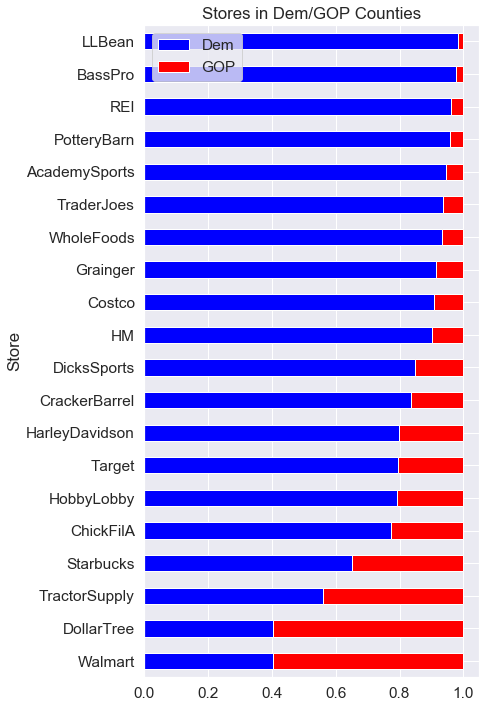

In [156]:



store_lean = sorted(store_lean, key=lambda x: x[1])
store_plot = pd.DataFrame(store_lean)
store_plot.columns = ['Store', 'Dem', 'GOP']

store_plot['TotalStores'] = store_plot['Store'].apply(lambda x: df_raw[x].sum())


ax = store_plot.plot(x='Store', 
                y={'Dem':'Dem', 'GOP':'GOP'}, 
                kind='barh', 
                stacked=True, 
                figsize=[6,12], 
                colormap='bwr',
                title='Stores in Dem/GOP Counties',
               )





In [157]:
total_pop = int(df_raw['population'].sum())


print('Population of Republican Counties: {:,}'.format(int(df_raw.groupby('blue').sum()['population'][0])))
print('Population of Democratic Counties: {:,}'.format(int(df_raw.groupby('blue').sum()['population'][1])))
#print('Percent of Total Population\n\tDemocratic: {.2f}\n\tRepublican: {:}'.format(int(df_raw.groupby('blue').sum()['population'][0]) / total_pop)

r = 'Republican Counties account for {:.1f}% of US population'.format(int(df_raw.groupby('blue').sum()['population'][0]) / total_pop * 100)
d = 'Democratic Counties account for {:.1f}% of US population'.format(int(df_raw.groupby('blue').sum()['population'][1]) / total_pop * 100)
print(r)
print(d)


Population of Republican Counties: 135,530,251
Population of Democratic Counties: 188,069,852
Republican Counties account for 41.9% of US population
Democratic Counties account for 58.1% of US population


In [158]:


print('Republican Counties: {}'.format(df_raw.groupby('blue').count()['index'][0]))
print('Democratic Counties: {}'.format(df_raw.groupby('blue').count()['index'][1]))


r = int(df_raw.groupby('blue').count()['index'][0]) / len(df_raw)
print('{:.1f}% of US counties are Republican.'.format(r*100))


Republican Counties: 2498
Democratic Counties: 605
80.5% of US counties are Republican.


In [174]:


d = df_raw.drop(columns=extra_cols+['index'], index=1).groupby('blue').sum().reset_index().iloc[1].sum()
r = df_raw.drop(columns=extra_cols+['index'], index=1).groupby('blue').sum().reset_index().iloc[0].sum()
print('{:,} stores in Republican counties, and {:,} in Democratic'.format(r, d))
print('{:.1f}% of all stores are in Democratic counties.'.format(d / (r+d) * 100))

15,201 stores in Republican counties, and 22,268 in Democratic
59.4% of all stores are in Democratic counties.


In [185]:
try:
    extra_cols.remove('blue')
except:
    pass


df_grouped = df_raw.drop(columns=extra_cols + ['index'], index=1).groupby('blue').sum().reset_index()

#drop_me = ['blue', 'index', 'totalvotes', 'candidatevotes', 'state_fips','population','area']

d = df_grouped.iloc[1].sum()
r = df_grouped.iloc[0].sum()

print('{:,} stores in Republican counties, and {:,} in Democratic'.format(r, d))
print('{:.1f}% of all stores are in Democratic counties.'.format(d / (r+d) * 100))

15,201 stores in Republican counties, and 22,268 in Democratic
59.4% of all stores are in Democratic counties.


# Do you have more Starbucks or DollarTree stores in your County?
Just an interesting experiment to see if a simple question like this could do well in ID of counties.  Doing this for a blog post

In [350]:
all_dem = df_bin['blue'].sum()
blue_tj = df_bin[(df_bin['blue']>0) & (df_bin['TraderJoes']>0)]['TraderJoes'].sum()
red_tj = df_bin[(df_bin['blue']==0) & (df_bin['TraderJoes']>0)]['TraderJoes'].sum()
blue_hm = df_bin[(df_bin['blue']>0) & (df_bin['HM']>0)]['HM'].sum()
red_hm = df_bin[(df_bin['blue']==0) & (df_bin['HM']>0)]['HM'].sum()
#blue_bp = df_bin[(df_bin['blue']>0) & (df_bin['BassPro']>0)]['BassPro'].sum()
#red_bp = df_bin[(df_bin['blue']==0) & (df_bin['BassPro']>0)]['BassPro'].sum()

In [351]:
print('There are', all_dem, 'total Democratic counties.')
print('There are', blue_tj, 'Democratic counties with Trader Joes')
print('There are', red_tj, 'Republican counties with Trader Joes')
print('There are', blue_hm, 'Democratic counties with H&M')
print('There are', red_hm, 'Republican counties with H&M')
#print('There are', blue_bp, 'Democratic counties with Bass Pro')
#print('There are', red_bp, 'Republican counties with Bass Pro')

There are 605 total Democratic counties.
There are 153 Democratic counties with Trader Joes
There are 40 Republican counties with Trader Joes
There are 193 Democratic counties with H&M
There are 115 Republican counties with H&M


In [404]:
df_bin[((#df_raw['TraderJoes'] 
         #+ df_raw['WholeFoods']
         #+ df_raw['Costco']
         #+ df_raw['Target']
         + df_raw['Starbucks']
         #+ df_raw['HM']
         - df_raw['DollarTree']
         #- df_raw['Walmart']
         #- df_raw['TractorSupply']
         #- df_raw['HobbyLobby']
        ) > 0)]['blue'].sum()
#df_bin[(df_bin['TraderJoes'] + df_bin['HM'] + df_bin['WholeFoods'] + df_bin['Starbucks'] + df_bin['Target']) > 1]['blue'].count()


f1, f2 = 'Starbucks', 'DollarTree'
print(len(df_raw[(df_raw[f1] - df_raw[f2]) > 0]))  #549
print(df_raw[(df_raw[f1] - df_raw[f2]) > 0]['blue'].sum())  #262

print(len(df_raw[(df_raw[f1] - df_raw[f2]) <= 0]))  #2554
print(df_raw[(df_raw[f1] - df_raw[f2]) <= 0]['blue'].sum())  #343




549
262
2554
343
193 153 40 0.7927461139896373


In [69]:
df_raw.head()

,index,state_fips,county,party,candidatevotes,totalvotes,fips,blue,WholeFoods,TractorSupply,Starbucks,AcademySports,DicksSports,BassPro,DollarTree,Grainger,ChickFilA,CrackerBarrel,HarleyDavidson,HM,HobbyLobby,LLBean,PotteryBarn,REI,Target,TraderJoes,Walmart,Costco,population,area
1,1,1,AUTAUGA,republican,225013.0,72148413.0,01001,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,55533,594.436
3,3,1,BALDWIN,republican,886133.0,72148413.0,01003,0,0,3,5,1,1,1,8,0,3,2,0,1,2,0,1,0,2,0,6,0,217855,1589.784
5,5,1,BARBOUR,republican,66244.0,72148413.0,01005,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,24872,884.876
7,7,1,BIBB,republican,88177.0,72148413.0,01007,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,22367,622.582
9,9,1,BLOUNT,republican,257928.0,72148413.0,01009,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,57771,644.776


In [81]:
extra_cols

['totalvotes',
 'county',
 'party',
 'fips',
 'state_fips',
 'candidatevotes',
 'population',
 'area',
 'index']

In [357]:
df_bin['WholeFoods'].sum()

208

index                                                       2140657
state_fips                                                    21515
county            AUTAUGABALDWINCALHOUNCULLMANELMOREETOWAHHOUSTO...
party             republicanrepublicanrepublicanrepublicanrepubl...
candidatevotes                                            1.787e+08
totalvotes                                              2.41394e+10
fips              0100101003010150104301051010550106901073010770...
blue                                                              0
WholeFoods                                                       71
TractorSupply                                                   720
Starbucks                                                      3587
AcademySports                                                   170
DicksSports                                                     277
BassPro                                                          34
DollarTree                                      